In [1]:
import imgaug.augmenters as iaa
import numpy as np

environments = {'dark' : iaa.Sequential([
                                        # iaa.BlendAlpha(0.5, foreground=iaa.Add(100), background=iaa.Multiply(0.2), seed=31),
                                        iaa.MultiplyAndAddToBrightness(mul=0.4, add=-15, seed=1991)]),
                'fog'  : iaa.Sequential([iaa.CloudLayer(intensity_mean=225, intensity_freq_exponent=-2, intensity_coarse_scale=2, alpha_min=1.0,
                                        alpha_multiplier=0.9, alpha_size_px_max=10, alpha_freq_exponent=-2, sparsity=0.9, density_multiplier=0.5, seed=35)]),
                'rain' : iaa.Sequential([iaa.Rain(drop_size=(0.05, 0.1), speed=(0.04, 0.06), seed=38),
                                        iaa.Rain(drop_size=(0.05, 0.1), speed=(0.04, 0.06), seed=35),
                                        iaa.Rain(drop_size=(0.1, 0.2), speed=(0.04, 0.06), seed=73),
                                        iaa.Rain(drop_size=(0.1, 0.2), speed=(0.04, 0.06), seed=93),
                                        iaa.Rain(drop_size=(0.05, 0.2), speed=(0.04, 0.06), seed=95)]),
                'snow' : iaa.Sequential([iaa.Snowflakes(flake_size=(0.5, 0.8), speed=(0.007, 0.03), seed=38),
                                        iaa.Snowflakes(flake_size=(0.5, 0.8), speed=(0.007, 0.03), seed=35),
                                        iaa.Snowflakes(flake_size=(0.6, 0.9), speed=(0.007, 0.03), seed=74),
                                        iaa.Snowflakes(flake_size=(0.6, 0.9), speed=(0.007, 0.03), seed=94),
                                        iaa.Snowflakes(flake_size=(0.5, 0.9), speed=(0.007, 0.03), seed=96)]),
                'fog_rain' : iaa.Sequential([iaa.CloudLayer(intensity_mean=225, intensity_freq_exponent=-2, intensity_coarse_scale=2, alpha_min=1.0,
                                            alpha_multiplier=0.9, alpha_size_px_max=10, alpha_freq_exponent=-2, sparsity=0.9, density_multiplier=0.5, seed=35),
                                            iaa.Rain(drop_size=(0.05, 0.2), speed=(0.04, 0.06), seed=35),
                                            iaa.Rain(drop_size=(0.05, 0.2), speed=(0.04, 0.06), seed=36)]),
                'fog_snow' : iaa.Sequential([iaa.CloudLayer(intensity_mean=225, intensity_freq_exponent=-2, intensity_coarse_scale=2, alpha_min=1.0,
                                            alpha_multiplier=0.9, alpha_size_px_max=10, alpha_freq_exponent=-2, sparsity=0.9, density_multiplier=0.5, seed=35),
                                            iaa.Snowflakes(flake_size=(0.5, 0.9), speed=(0.007, 0.03), seed=35),
                                            iaa.Snowflakes(flake_size=(0.5, 0.9), speed=(0.007, 0.03), seed=36)]),
                'rain_snow' : iaa.Sequential([iaa.Snowflakes(flake_size=(0.5, 0.8), speed=(0.007, 0.03), seed=35),
                                            iaa.Rain(drop_size=(0.05, 0.1), speed=(0.04, 0.06), seed=35),
                                            iaa.Rain(drop_size=(0.1, 0.2), speed=(0.04, 0.06), seed=92),
                                            iaa.Rain(drop_size=(0.05, 0.2), speed=(0.04, 0.06), seed=91),
                                            iaa.Snowflakes(flake_size=(0.6, 0.9), speed=(0.007, 0.03), seed=74)]),
                'light': iaa.Sequential([iaa.MultiplyAndAddToBrightness(mul=1.6, add=(0, 30), seed=1992)]),
                'wind' : iaa.Sequential([iaa.MotionBlur(15, seed=17)])
                }


不同天气

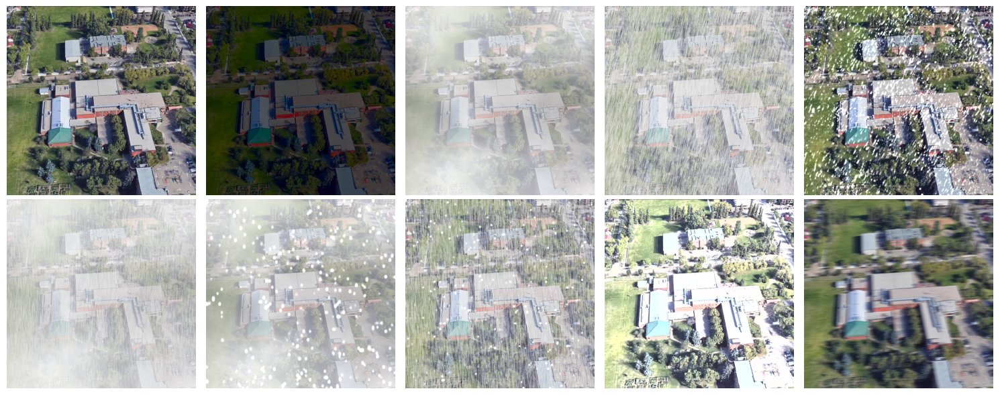

In [2]:
query_path = "University-Release/test/query_drone/0000/image-01.jpeg"

import matplotlib.pyplot as plt

img = plt.imread(query_path)
plt.figure(figsize=(15, 6))
plt.subplot(2, 5, 1)
plt.imshow(img)
plt.axis('off')
for cnt, aug in enumerate(environments):
    plt.subplot(2, 5, cnt+2)
    plt.imshow(environments[aug](image=img))
    plt.axis('off')

plt.tight_layout()  
plt.show()

相同天气

In [43]:


import matplotlib.pyplot as plt

def get_img_freq(img):
    #reference fft
    fre = np.fft.fft2(img[:,:,channel]) 
    fre_shift = np.fft.fftshift(fre)
    fre_shift = np.abs(fre_shift)
    ret = 15 * np.log(fre_shift)
    return ret

def show_difference(query_path = "University-Release/test/query_drone/0000/image-01.jpeg", weather= 'rain', nums = 5):
    channel = 0
    img = plt.imread(query_path)
    enhanced_imgs = []
    enhanced_imgs_i_d = []
    enhanced_imgs_f_d = []


    f0 = get_img_freq(img)

    for i in range(nums):
        x = environments[weather](image=img)
        enhanced_imgs.append(x)

        reference = img[:,:,channel].astype(np.float)
        compare = x[:,:,channel].astype(np.float)
        compare.astype(np.float)

        xx = compare - (reference + 1e-11) 
        enhanced_imgs_i_d.append(xx)

        #
        f = get_img_freq(x)
        xxx = f - (f0 + 1e-6)
        enhanced_imgs_f_d.append(xxx)

        



    # show visual result
    plt.figure(figsize=(15, 9))
    plt.subplot(2, nums, 1)
    plt.imshow(img)
    plt.axis('off')
    for cnt in range(nums):
        plt.subplot(3, nums, cnt+1)
        plt.imshow(enhanced_imgs[cnt])
        plt.axis('off')

    # show visual difference
    for cnt in range(nums):
        plt.subplot(3, nums, cnt+6)
        plt.imshow(enhanced_imgs_i_d[cnt], cmap='gray')
        plt.axis('off')

    # show visual difference
    for cnt in range(nums):
        plt.subplot(3, nums, cnt+11)
        plt.imshow(enhanced_imgs_f_d[cnt], cmap='gray')
        plt.axis('off')

    plt.tight_layout()  
    plt.show()



C:\Users\lyq\AppData\Local\Temp\ipykernel_11596\919658947.py:47: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(3, nums, cnt+1)


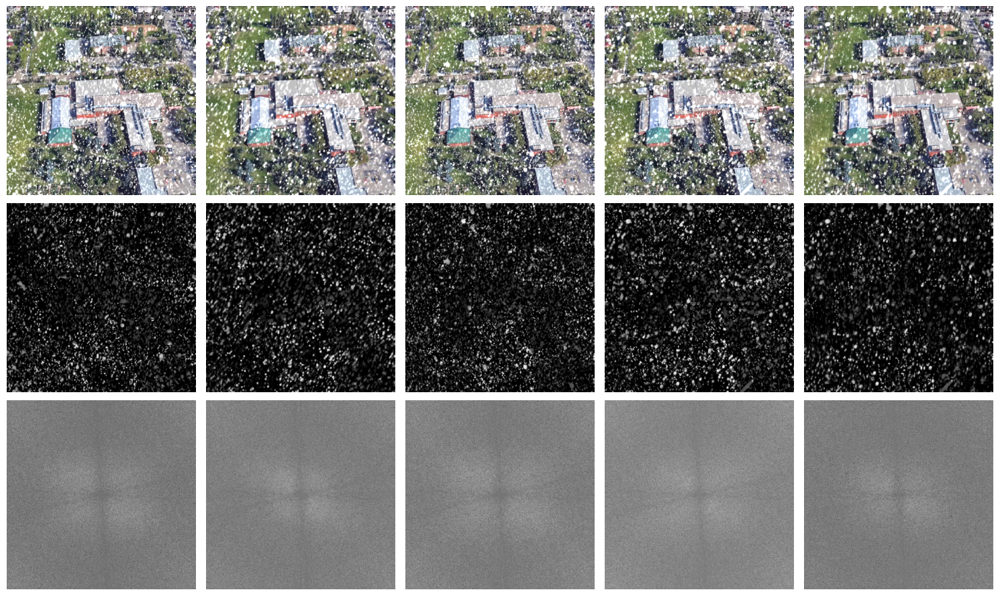

In [52]:
show_difference(weather='snow')

C:\Users\lyq\AppData\Local\Temp\ipykernel_11596\919658947.py:47: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(3, nums, cnt+1)


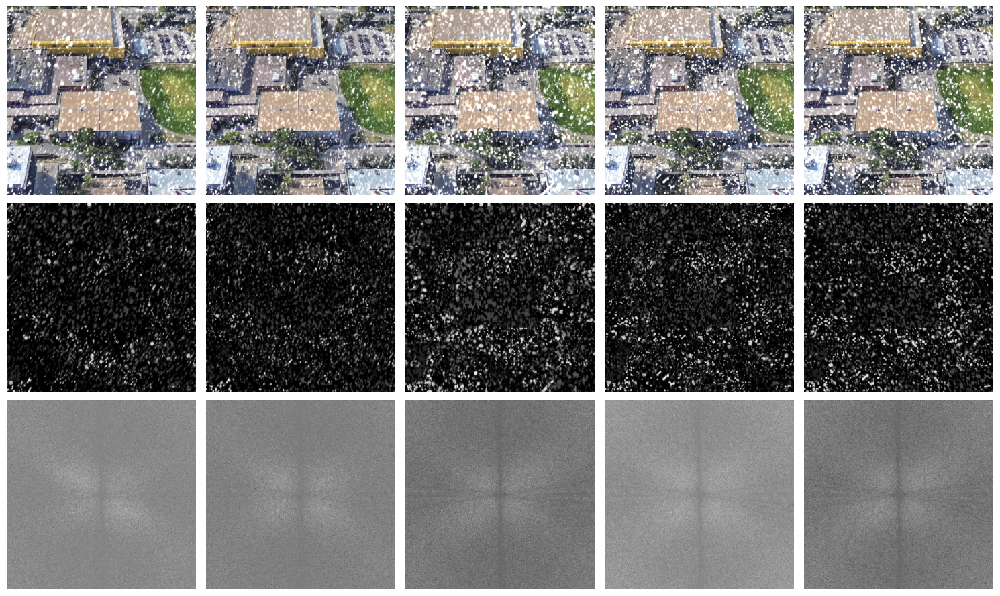

In [55]:
show_difference(query_path = "University-Release/test/query_drone/0001/image-01.jpeg", weather='snow')

C:\Users\lyq\AppData\Local\Temp\ipykernel_11596\919658947.py:47: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(3, nums, cnt+1)


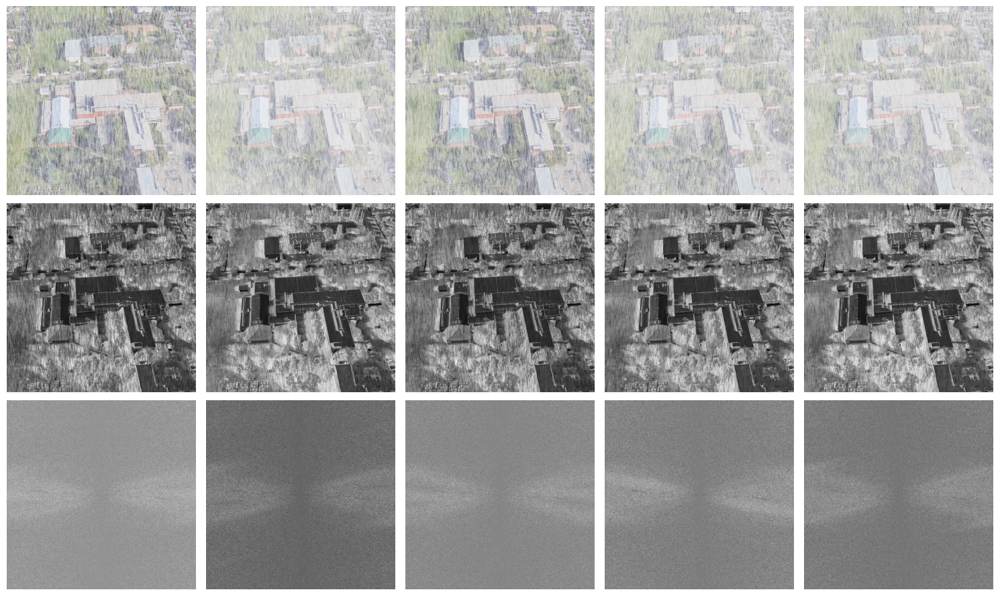

In [56]:
show_difference(weather='rain')

C:\Users\lyq\AppData\Local\Temp\ipykernel_11596\919658947.py:47: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(3, nums, cnt+1)


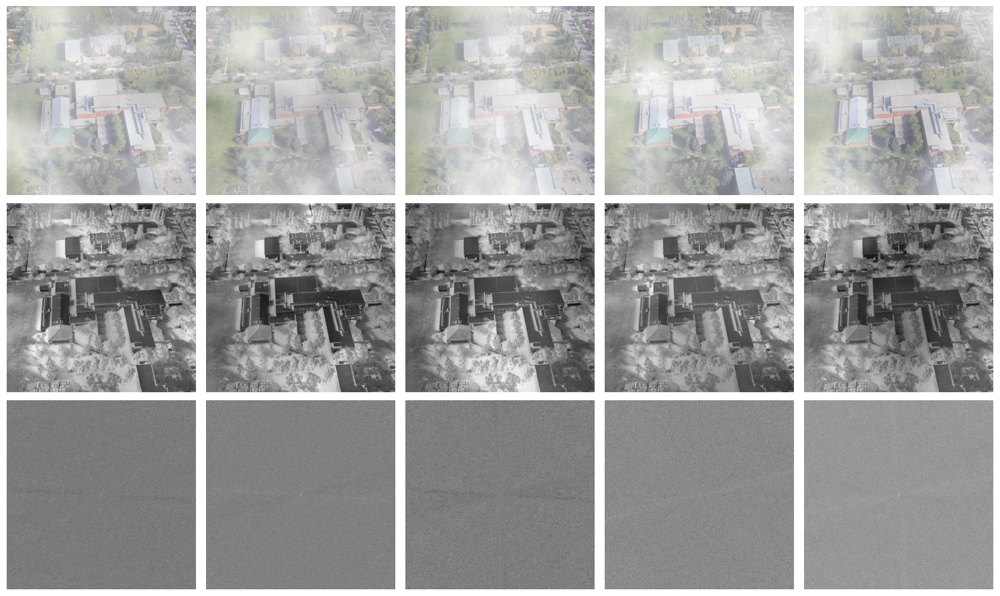

In [46]:
show_difference(weather='fog')

C:\Users\lyq\AppData\Local\Temp\ipykernel_11596\919658947.py:47: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(3, nums, cnt+1)


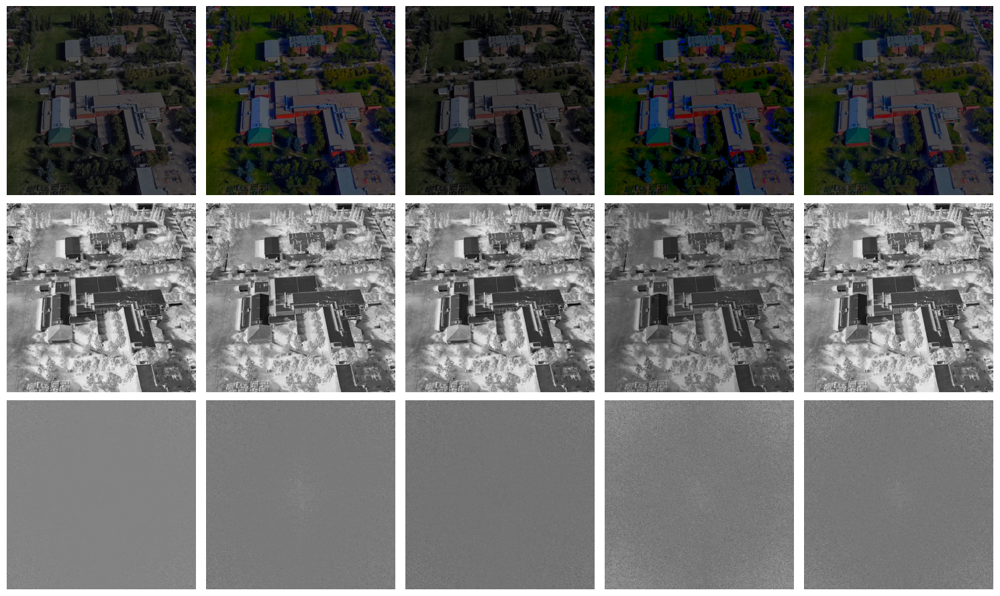

In [57]:
show_difference(weather='dark')

C:\Users\lyq\AppData\Local\Temp\ipykernel_11596\919658947.py:47: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(3, nums, cnt+1)


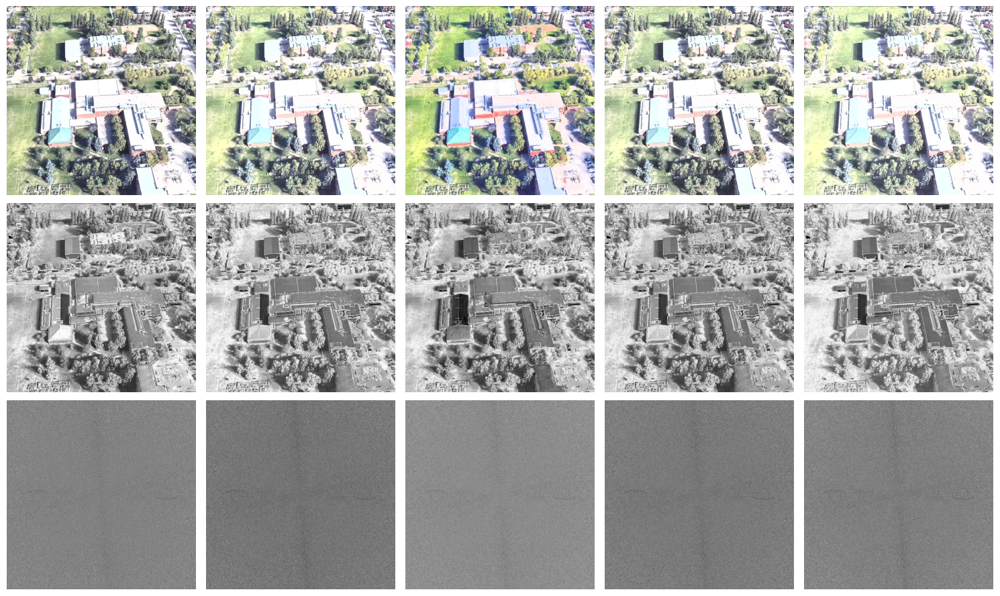

In [58]:
show_difference(weather='light')

C:\Users\lyq\AppData\Local\Temp\ipykernel_11596\919658947.py:47: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(3, nums, cnt+1)


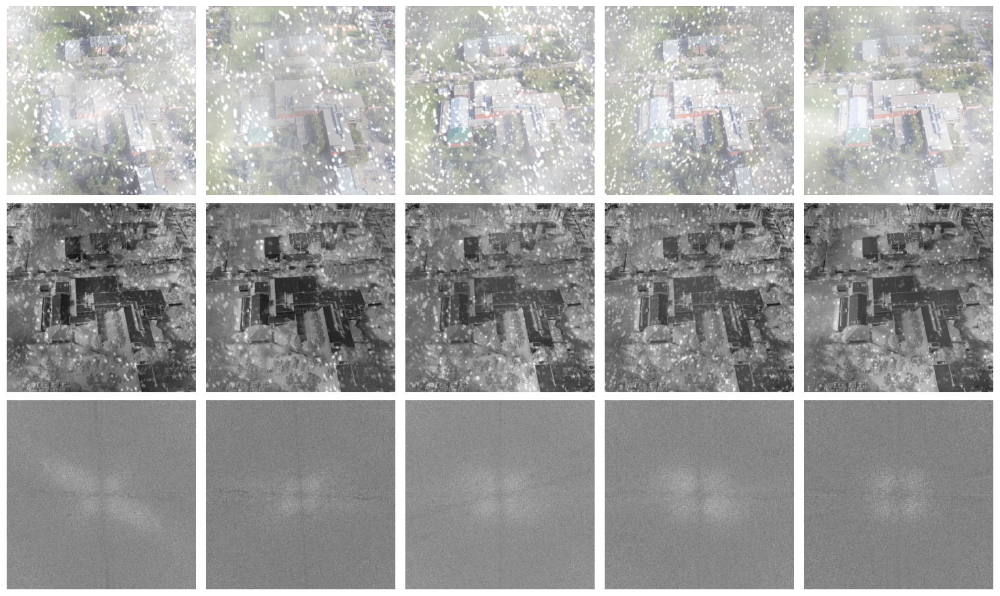

In [61]:

show_difference(weather='fog_snow')

C:\Users\lyq\AppData\Local\Temp\ipykernel_11596\919658947.py:47: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(3, nums, cnt+1)


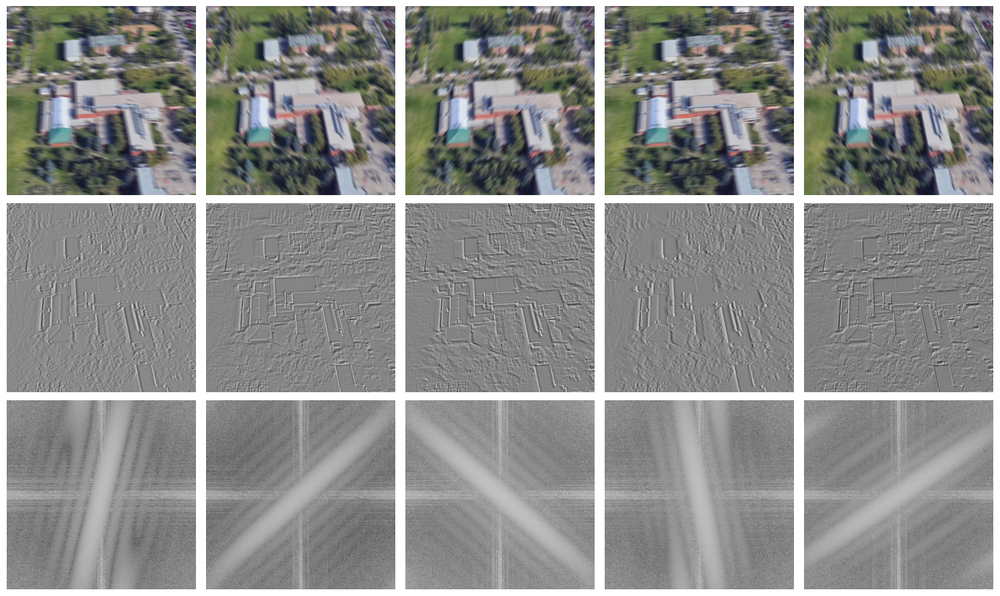

In [59]:
show_difference(weather='wind')